In [306]:
%load_ext autoreload
%autoreload 2

import yaml
import json
from constants import json_ids
import matplotlib.pyplot as plt
import cv2
from PIL import Image,ImageDraw, ImageFont


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [307]:
##Config file
with open("config.yml", "r") as ymlfile:
    config = yaml.load(ymlfile, Loader=yaml.FullLoader)

## FormRecognizer API
- 


In [308]:
test = "hello\n world"
"\n" in test

True

In [309]:
def show_img(image, title=''):
    dim = 20
    plt.figure(figsize=(dim, dim))
    plt.title(title)
    plt.imshow(image)

def display_bb_cloud_vision(source, json_data, show_text=False):
    #img = cv2.imread(source, cv2.IMREAD_COLOR)
    file_name = source.split("/")[-1]
    with Image.open(source) as img:
        line_length = 30
        for box in json_data:
            try:
                text, vertices = box["description"], box["boundingPoly"]["vertices"]
                if '\n' in text:
                    continue
            except:
                raise Exception("Vertices not found..")
            draw_bb_cloud_vision(img, source, vertices, show_text, text=text)
        show_img(img, title=file_name)

def draw_bb_cloud_vision_cv(img, vertices, line_length):
    
    x1, y1 = vertices[0]['x'], vertices[0]['y']
    x2, y2 = vertices[3]['x'], vertices[3]['y']
    x3, y3 = vertices[1]['x'], vertices[1]['y']
    x4, y4 = vertices[2]['x'], vertices[2]['y'] 

    cv2.circle(img, (x1, y1), 3, (255, 0, 255), -1)    #-- top_left
    cv2.circle(img, (x2, y2), 3, (255, 0, 255), -1)    #-- bottom-left
    cv2.circle(img, (x3, y3), 3, (255, 0, 255), -1)    #-- top-right
    cv2.circle(img, (x4, y4), 3, (255, 0, 255), -1)    #-- bottom-right

    cv2.line(img, (x1, y1), (x1 , y1 + line_length), (0, 255, 0), 2)  #-- top-left
    cv2.line(img, (x1, y1), (x1 + line_length , y1), (0, 255, 0), 2)

    cv2.line(img, (x2, y2), (x2 , y2 - line_length), (0, 255, 0), 2)  #-- bottom-left
    cv2.line(img, (x2, y2), (x2 + line_length , y2), (0, 255, 0), 2)

    cv2.line(img, (x3, y3), (x3 - line_length, y3), (0, 255, 0), 2)  #-- top-right
    cv2.line(img, (x3, y3), (x3, y3 + line_length), (0, 255, 0), 2)

    cv2.line(img, (x4, y4), (x4 , y4 - line_length), (0, 255, 0), 2)  #-- bottom-right
    cv2.line(img, (x4, y4), (x4 - line_length , y4), (0, 255, 0), 2)
    
    return img

def read_annotations_cloud_vision(source):
    with open(source) as json_file:
        data = json.load(json_file)
    res = data['responses'][0]["textAnnotations"]
    return data['responses'][0]["textAnnotations"]

def draw_bb_cloud_vision(img, source, vertices, show_text=False, text=None):
    file_name = source.split("/")[-1]
    try:
        x1, y1 = vertices[0]['x'], vertices[0]['y']
        x2, y2 = vertices[3]['x'], vertices[3]['y']
        x3, y3 = vertices[1]['x'], vertices[1]['y']
        x4, y4 = vertices[2]['x'], vertices[2]['y'] 
    except:
        print(file_name)
        print("not complete vertices:", vertices)
        
        #return img
        raise Exception("Coordinates not complete..")
    
    # Draw red and yellow triangles on it and save
    draw = ImageDraw.Draw(img)
    #draw.polygon([(20,10), (200, 200), (100,20)])
    draw.polygon([(x1,y1), (x3,y3), (x4, y4), (x2, y2)], outline="red")
    if show_text:
        x, y = x1, y1
        a, b = x4, y4
        #font_size = min(abs(y-b) // 2, 20)
        font_size = 20

        fnt = ImageFont.truetype(config["base_path"] + 'arial.ttf', font_size)
        w, h = fnt.getsize(text)
        draw.rectangle((x, y-h, x + w, y), fill=(0,0,0,0))
        draw.text((x, y-h), text, font=fnt, fill=(209, 239, 8) )
    return img

In [310]:
########### Python Form Recognizer Async Layout #############
json_sources = [config["base_path"] + "cropped_json_files/%s.nutrition.cropped.json" %img_id for img_id in json_ids]
img_sources = [config["base_path"] + "cropped_images/%s.nutrition.cropped.jpg" %img_id for img_id in json_ids]

0000901881036.nutrition.cropped.jpg
not complete vertices: [{'x': 5, 'y': 462}, {'x': 47, 'y': 468}, {'x': 42, 'y': 504}, {'y': 499}]
0002000005924.nutrition.cropped.jpg
not complete vertices: [{'y': 747}, {'x': 222, 'y': 747}, {'x': 222, 'y': 785}, {'y': 785}]
0002000006143.nutrition.cropped.jpg
not complete vertices: [{'x': 347}, {'x': 400, 'y': 23}, {'x': 387, 'y': 53}, {'x': 334, 'y': 29}]
0002000008314.nutrition.cropped.jpg
not complete vertices: [{'x': 489, 'y': 3}, {'x': 486, 'y': 47}, {'x': 452, 'y': 44}, {'x': 455}]
0002000021337.nutrition.cropped.jpg
not complete vertices: [{'x': 1, 'y': 1136}, {'x': 123, 'y': 1137}, {'x': 122, 'y': 1199}, {'y': 1198}]
00078085.nutrition.cropped.jpg
not complete vertices: [{'x': 1442}, {'x': 1637, 'y': 1}, {'x': 1637, 'y': 42}, {'x': 1442, 'y': 41}]
0014100170969.nutrition.cropped.jpg
not complete vertices: [{'x': 257, 'y': 12}, {'x': 315}, {'x': 321, 'y': 32}, {'x': 263, 'y': 43}]
0016000275171.nutrition.cropped.jpg
not complete vertices: [{

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


0031200005595.nutrition.cropped.jpg
not complete vertices: [{'y': 24}, {'x': 389, 'y': 24}, {'x': 389, 'y': 97}, {'y': 97}]
0032894010919.nutrition.cropped.jpg
not complete vertices: [{'x': 352, 'y': 5}, {'x': 414}, {'x': 416, 'y': 26}, {'x': 354, 'y': 31}]
0032894010926.nutrition.cropped.jpg
not complete vertices: [{'x': 8, 'y': 672}, {'x': 81, 'y': 678}, {'x': 73, 'y': 780}, {'y': 775}]
0034000124138.nutrition.cropped.jpg
not complete vertices: [{'x': 5, 'y': 37}, {'x': 203, 'y': 42}, {'x': 198, 'y': 238}, {'y': 233}]
0034000433032.nutrition.cropped.jpg
not complete vertices: [{'x': 784, 'y': 2}, {'x': 866}, {'x': 867, 'y': 49}, {'x': 786, 'y': 52}]


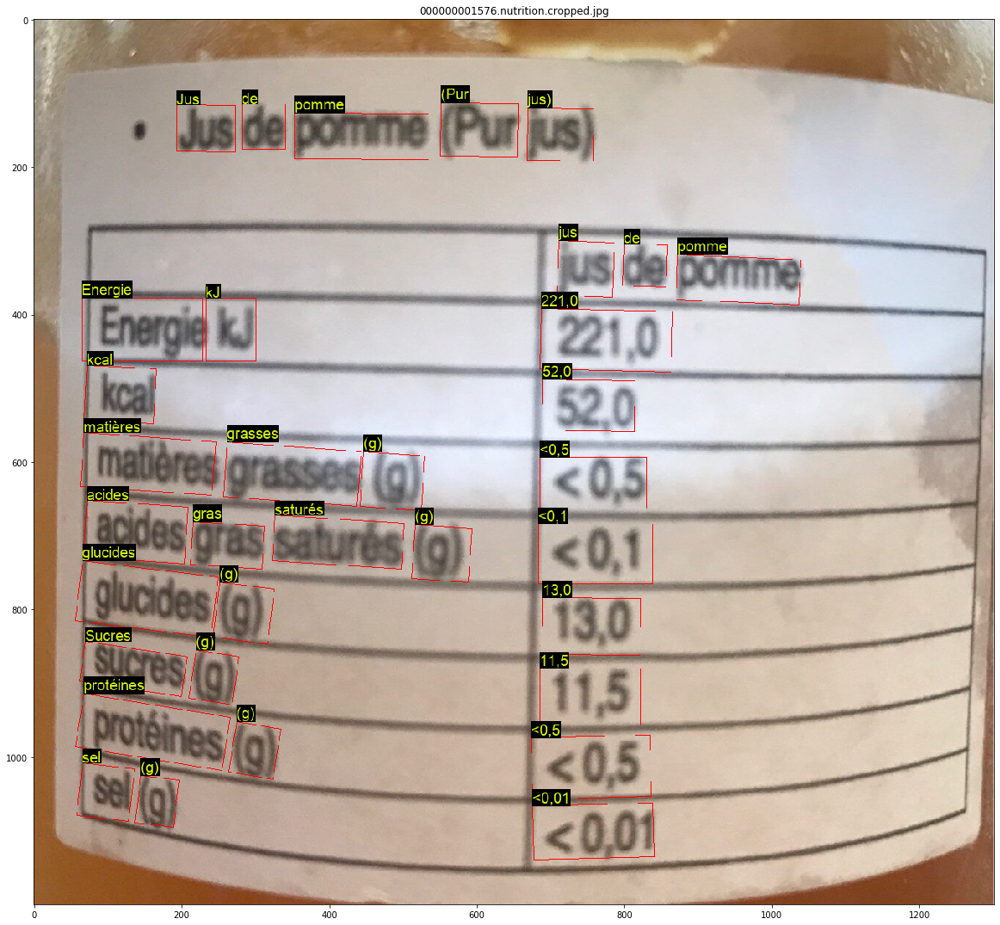

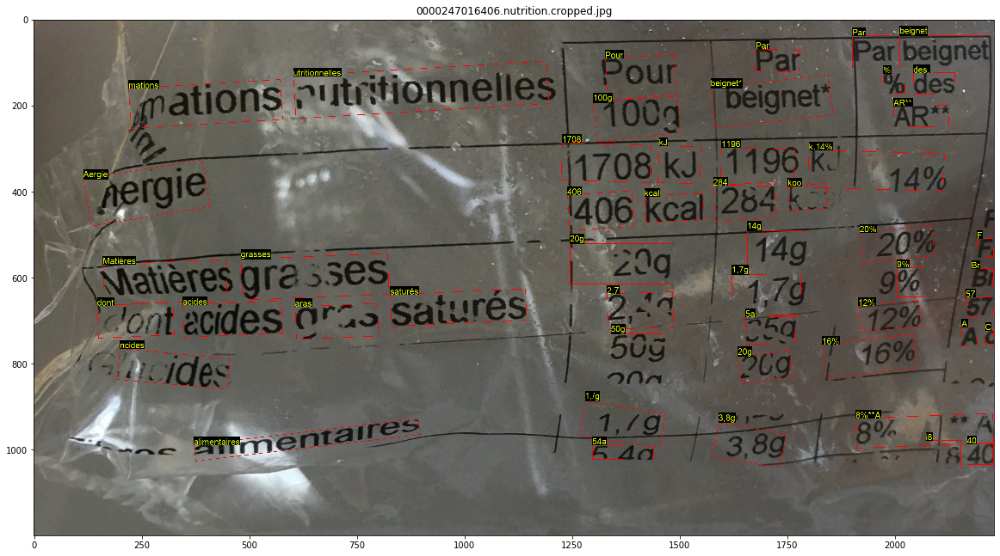

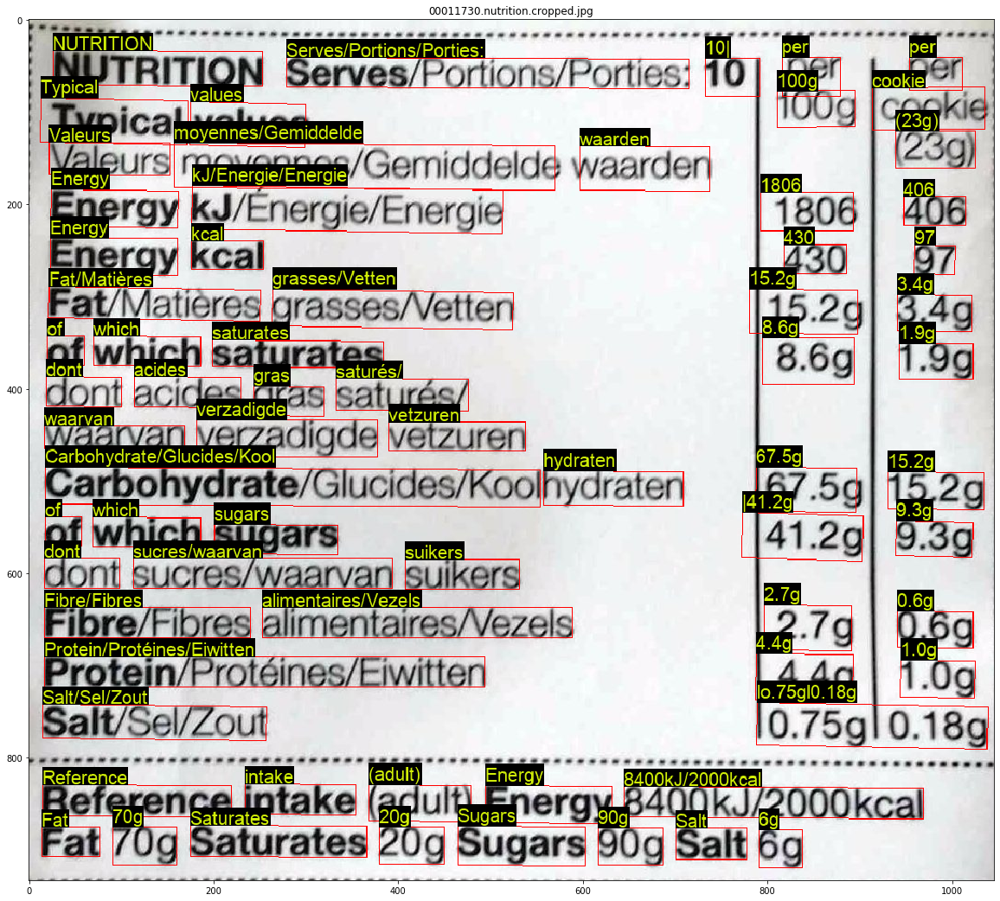

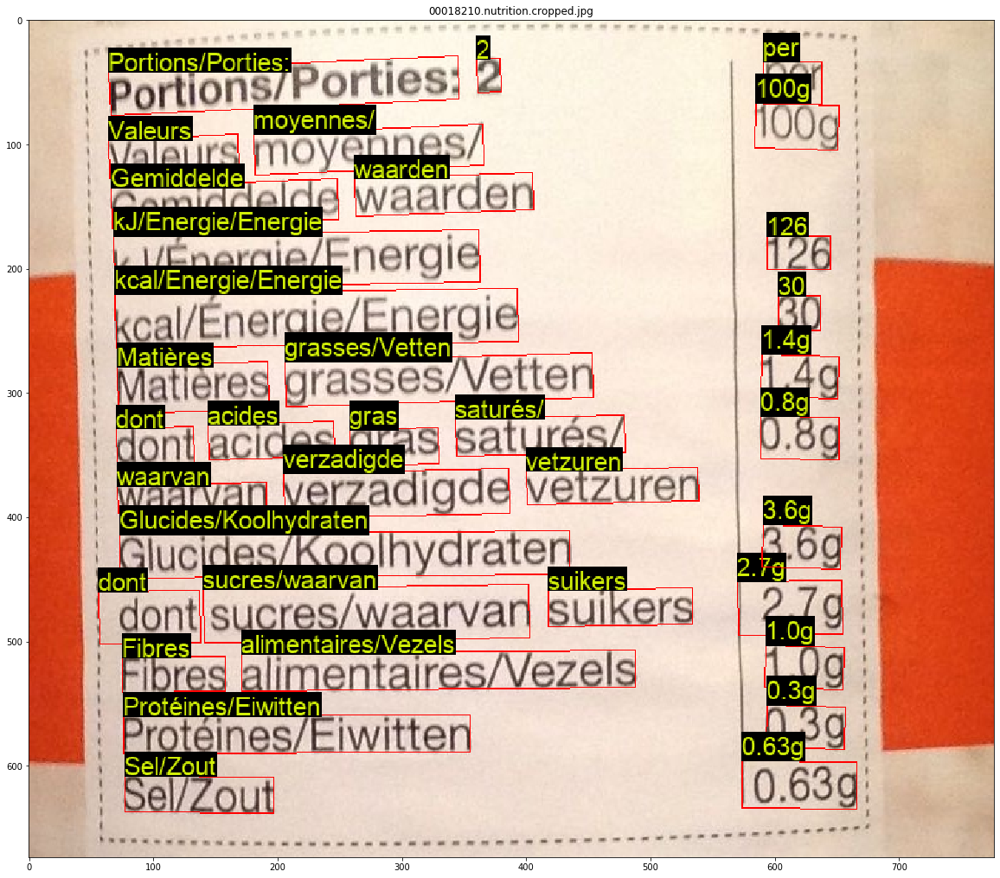

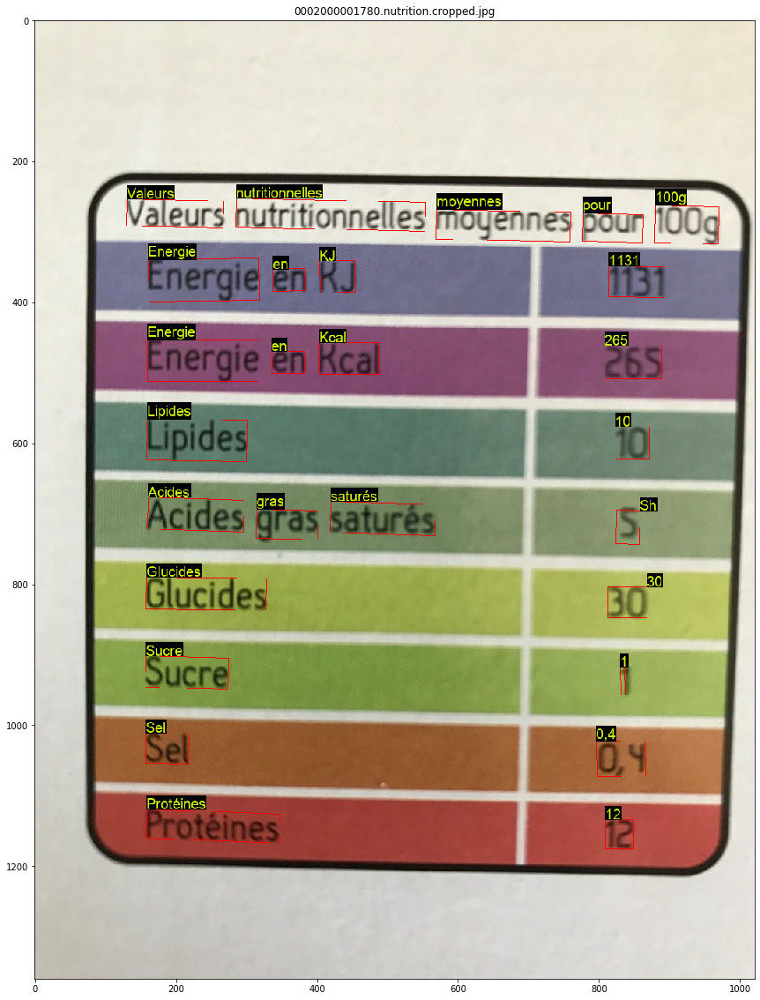

...

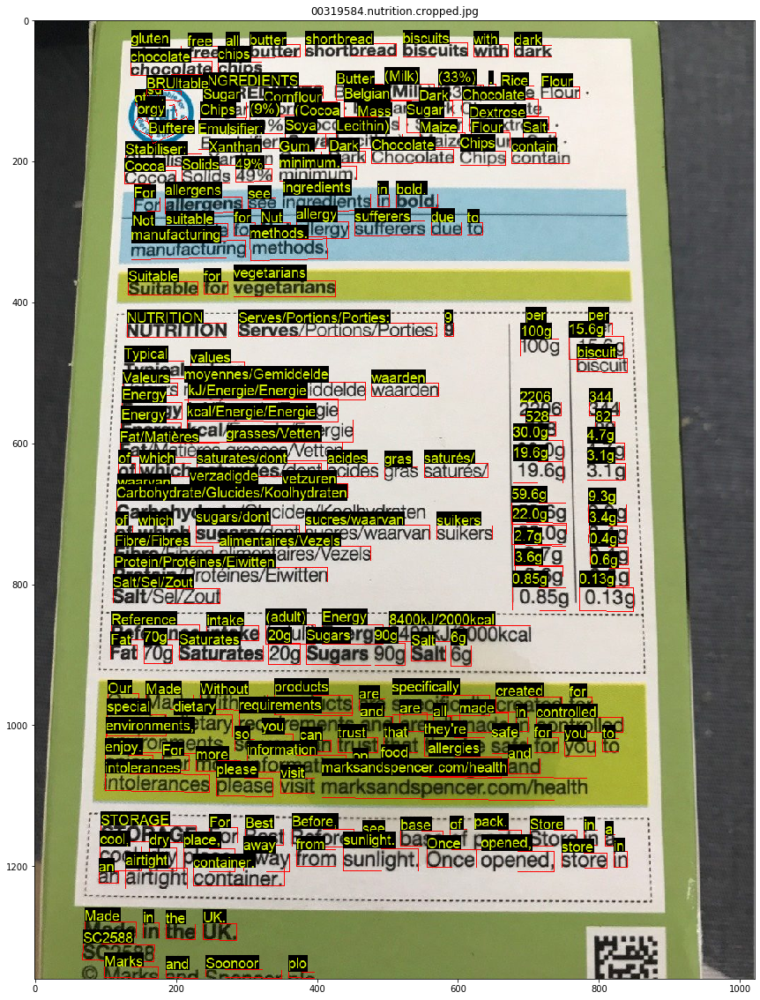

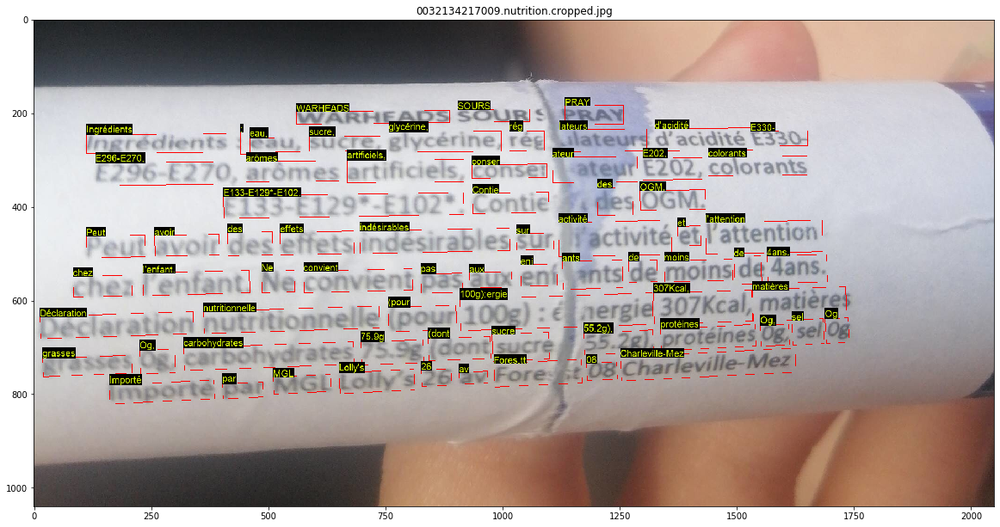

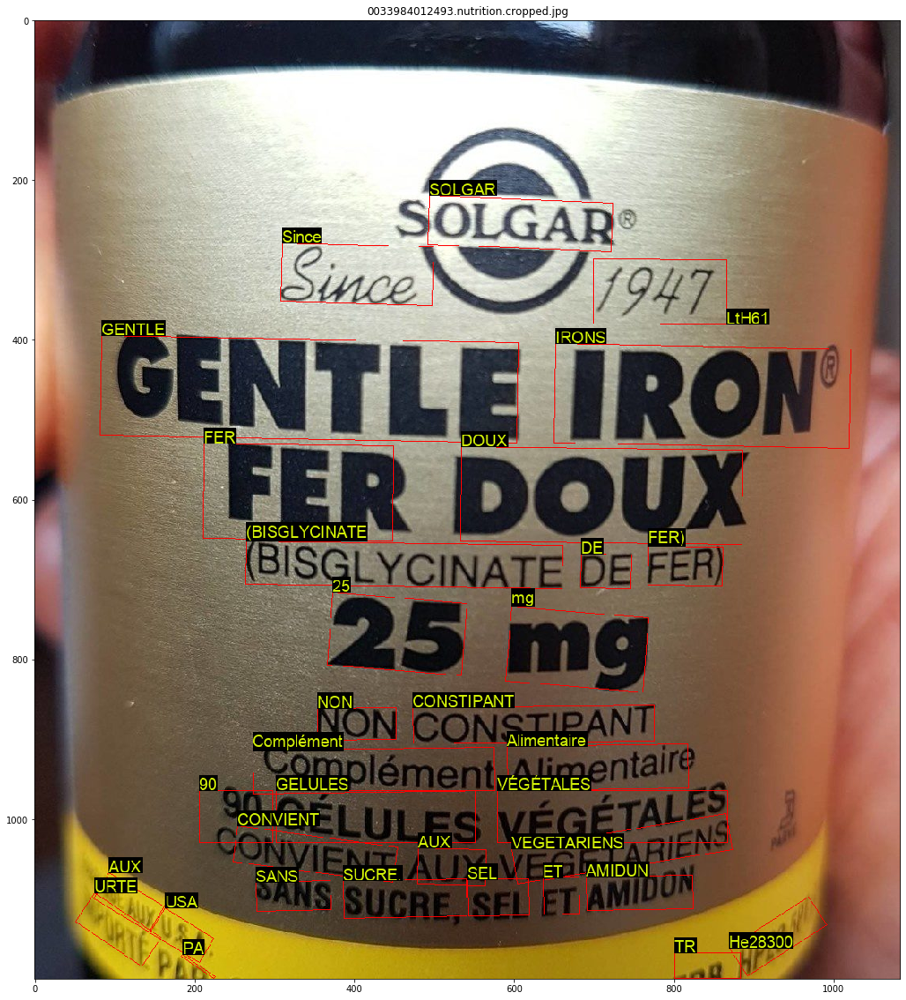

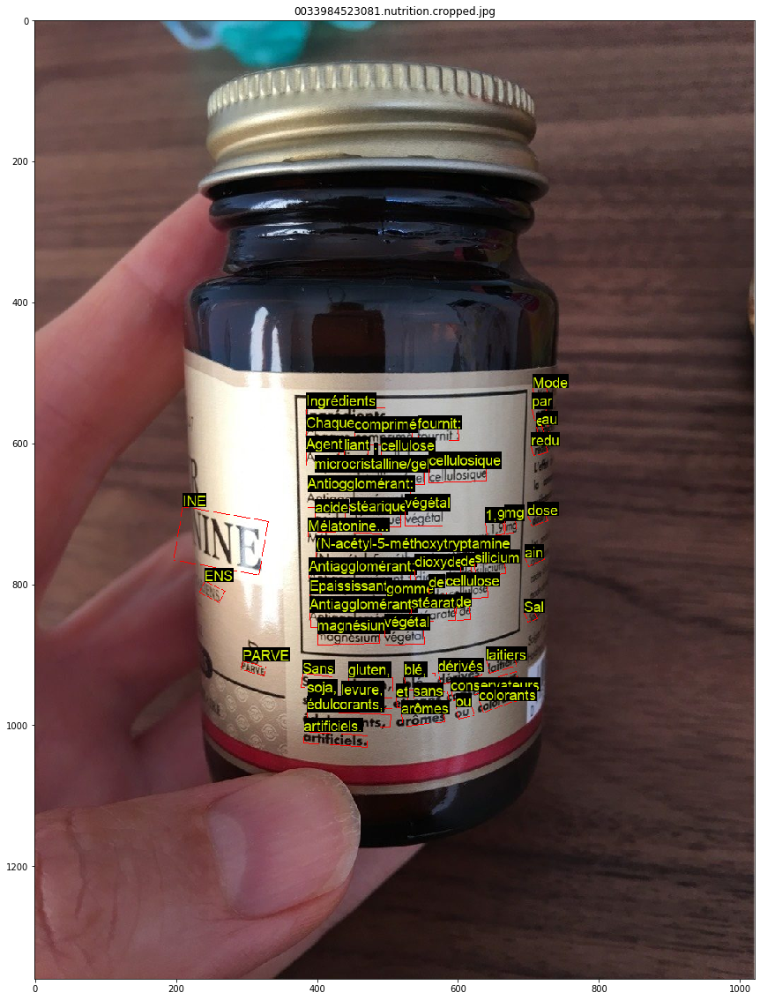

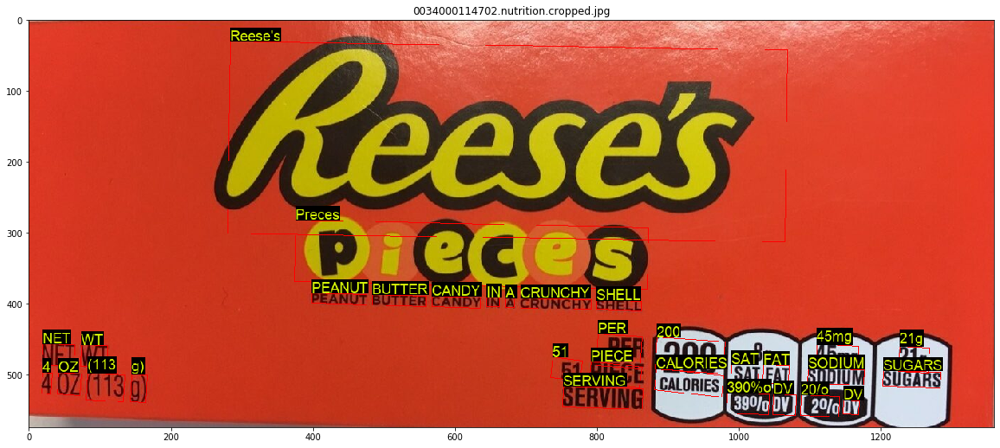

In [72]:
for (json_source, img_source) in zip(json_sources, img_sources):
    json_data = read_annotations_cloud_vision(json_source)
    try:
        display_bb_cloud_vision(img_source, json_data, show_text=True)
    except:
        continue
        

In [313]:
# Improting Image class from PIL module 
from PIL import Image 


img_id = "0000901881036"
#img_id = "3560071139902"

# Opens a image in RGB mode 
im = Image.open(config["base_path"] + "image_files/%s.nutrition.jpg" %img_id) 
im_cropped = Image.open(config["base_path"] + "cropped_images/%s.nutrition.cropped.jpg" %img_id) 
# Size of the image in pixels (size of orginal image) 
# (This is not mandatory) 
width, height = im.size 
  
# Setting the points for cropped image 

x_top_left = 180
y_top_left = 80
x_bottom_right = 900
y_bottom_right = 790

# Cropped image of above dimension 
# (It will not change orginal image) 
#im1 = im.crop((left, top, right, bottom)) 
im1 = im.crop((x_top_left, y_top_left, x_bottom_right, y_bottom_right))
  
# Shows the image in image viewer 
im1.show() 

In [314]:
2*height/3

800.0

In [315]:
height, width

(1200, 674)

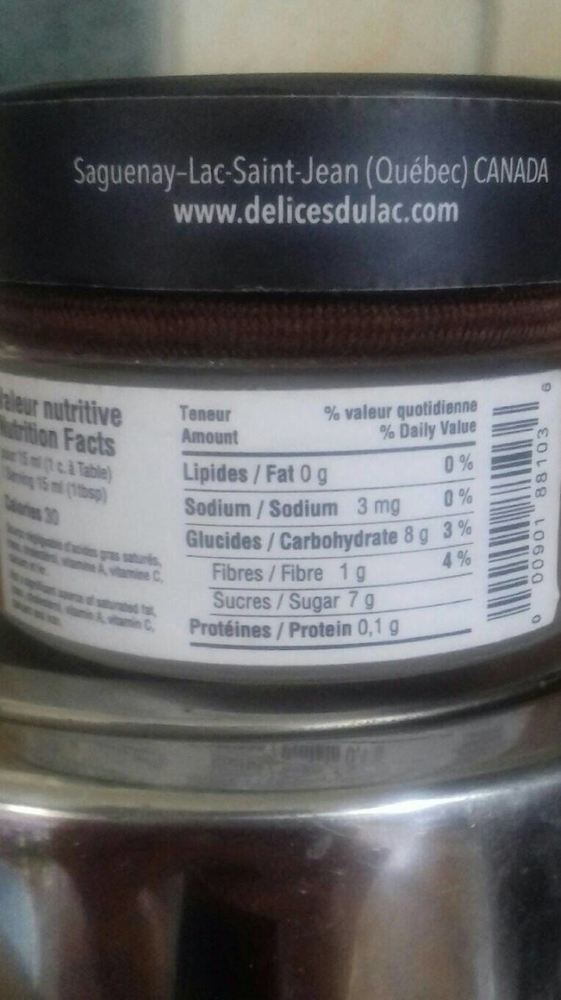

In [316]:
im

In [289]:
#im_cropped

In [317]:
"""
0000901881036
0002000006143
3459860003589 #no file
8712100536915
3700531213173 #no file
09633134 #no file
05737161 #no file
2600 #no file
"""
#img_id = "2600"

img_id = "0000901881036"
json_sources = [config["base_path"] + "cropped_json_files/%s.nutrition.cropped.json" %img_id]
img_sources = [config["base_path"] + "cropped_images/%s.nutrition.cropped.jpg" %img_id ]

for (json_source, img_source) in zip(json_sources, img_sources):
    json_data = read_annotations_cloud_vision(json_source)
    try:
        display_bb_cloud_vision(img_source, json_data, show_text=True)
    except:
        continue
        

0000901881036.nutrition.cropped.jpg
not complete vertices: [{'x': 5, 'y': 462}, {'x': 47, 'y': 468}, {'x': 42, 'y': 504}, {'y': 499}]
